In [1]:
import os
import nibabel as nib
import numpy as np
from scipy.ndimage import gaussian_filter1d
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from lameg.util import get_bigbrain_layer_boundaries, load_meg_sensor_data
from scipy.signal import find_peaks
from scipy.interpolate import interp1d
# from dtw import *
from scipy.signal import correlate
import glob
import numpy as np
import matplotlib.pyplot as plt
import sys
import pandas as pd


def minmax_unit(x):
    x = np.asarray(x)
    xmin, xmax = np.min(x), np.max(x)
    if xmax == xmin:
        return np.zeros_like(x)
    return 2 * (x - xmin) / (xmax - xmin) - 1


def upload_meg_file(rawdata_path, sub, ses, condition):
    """
    Search and upload the raw datachunck

    :param rawdata_path: datapath
    :param sub: subjects id
    :param ses: session id 
    :param condition: experimental condition (block-wise)
    """
    
    sub_meg_path = os.path.join(rawdata_path, "sub-" + sub , "ses-0" + ses , "meg/sub-"+ sub + "_ses-0" + ses + "_task-" + condition + "_acq-")
    folders_acq = glob.glob(sub_meg_path + "*_meg.ds", recursive=True)
    list_folders = sorted(folders_acq, key=lambda x: int(x.split('acq-')[1].split('_')[0]))
    
    return list_folders

def align_to_abs_peak_with_edges_time(X, start_time=-0.3, peak_window=(0.05, 0.150), fs=600):
    """
    :param X: array (n_series, n_time)
    :param start_time: time of first sample (-0.3 или -0.5)
    :param peak_window; (t1, t2) in seconds — the window within which we search for |peak|
    :param fs: sampling frequency (default 600 Hz)

    Returns:
    lags:  shifts (n_series,)
    align_idx: indexes for alignment (list)
    peaks: peaks found for each participant
    ref_peak: average peak position
    """

    X = np.asarray(X)
    n_series, n_time = X.shape
    times = start_time + np.arange(n_time) / fs
    t1, t2 = peak_window
    i1 = np.searchsorted(times, t1)
    i2 = np.searchsorted(times, t2)
    i1 = max(0, i1)
    i2 = min(n_time, i2)
    peaks = np.array([
        i1 + np.argmax(np.abs(x[i1:i2]))
        for x in X
    ])
    ref_peak = int(round(np.mean(peaks)))
    lags = ref_peak - peaks

    base = np.arange(n_time)
    align_idx = [
        np.clip(base - lag, 0, n_time - 1)
        for lag in lags
    ]

    return lags, align_idx

def split_into_6_layers(n_layers, bb_bounds):
    """
    For a number of layers used for laminar inference take the BigBrain atlas indices of the 6 cortical layers and match them

    :param n_layers: chosen number of laters 
    :param bb_bounds : indices of the BB atlas

    """
    
    layers = np.arange(n_layers)
    idx = []
    raw_idx = [
        np.where(layers < bb_bounds[0])[0],
        np.where((layers >= bb_bounds[0]) & (layers < bb_bounds[1]))[0],
        np.where((layers >= bb_bounds[1]) & (layers < bb_bounds[2]))[0],
        np.where((layers >= bb_bounds[2]) & (layers < bb_bounds[3]))[0],
        np.where((layers >= bb_bounds[3]) & (layers < bb_bounds[4]))[0],
        np.where(layers >= bb_bounds[4])[0],
    ]

    for i in range(6):

        if len(raw_idx[i]) > 0:
            idx.append(raw_idx[i])
            continue

        left = i - 1
        while left >= 0 and len(raw_idx[left]) == 0:
            left -= 1
        right = i + 1
        while right <= 5 and len(raw_idx[right]) == 0:
            right += 1
        if left >= 0 and right <= 5:
            merged = np.arange(raw_idx[left][-1], raw_idx[right][0] + 1)
            idx.append(merged)
            print('Merged')

    return idx

In [ ]:
subjects=['sub-105', 'sub-107', 'sub-109', 'sub-113', 'sub-114',
           'sub-115', 'sub-117','sub-118','sub-119', 'sub-123', 
           'sub-124', 'sub-126','sub-127','sub-129', 'sub-130',
           'sub-131','sub-132','sub-133','sub-134','sub-135', 
           'sub-136', 'sub-137','sub-138', 'sub-141','sub-142',
           'sub-143','sub-144','sub-145']

sessions = {
    'sub-105': ['ses-01'], 'sub-107': ['ses-01'], 'sub-109': ['ses-01'], 'sub-113': ['ses-01'], 
    'sub-114': ['ses-01'], 'sub-115': ['ses-01'],'sub-117': ['ses-01'], 'sub-118': ['ses-01'], 
    'sub-119': ['ses-01'], 'sub-123': ['ses-01'],'sub-124': ['ses-01'], 'sub-126': ['ses-01'], 
    'sub-127': ['ses-01'], 'sub-129': ['ses-01'],'sub-130': ['ses-01'], 'sub-131': ['ses-01'],
    'sub-132': ['ses-01'], 'sub-133': ['ses-01'],'sub-134': ['ses-01'], 'sub-135': ['ses-01'], 
    'sub-136': ['ses-01'], 'sub-137': ['ses-01'], 'sub-138': ['ses-01'],'sub-141': ['ses-01'], 
    'sub-142': ['ses-01'], 'sub-143': ['ses-01'], 'sub-144': ['ses-01'],
    'sub-145': ['ses-01']
}

n_layers=11
time_lims=[- 300,300]
out_dir=""
braindyn_files = ""
figures_path = ""
meg_rawdata_path = ""

# all_snrs=[]


SUB = ['105', '107', '109', '113', '114',
        '115', '117','118','119', '123', 
        '124', '126','127','129', '130',
        '131','132','133','134', '135', 
        '136', '137','138', '141','142',
        '143','144','145']

ses = "1"
condition = "V100V100"
mxf_option = "no_mxf" 
trigger = "right_stim" # just for SNR computation

snrs_subj = []

for s, sub in enumerate(SUB): 
    
    print(f"Computing part {sub} SNR")

    list_folders = upload_meg_file(meg_rawdata_path, sub, ses, condition)
    mxf_path_dir = os.path.join(list_folders[-1], f"mxf_{mxf_option}_data")

    output_spm_conv_dir = os.path.join(mxf_path_dir, "mxf_sess_data", "spm_convert_epo")
    spm_converted_file = f"spm_sub-{sub}_ses-0{ses}_task-{condition}_meg_{mxf_option}_{trigger}_nrg_ERF_epo"
    base_fname = os.path.join(output_spm_conv_dir,spm_converted_file + ".mat")

    sensor_data, sensor_time, ch_names = load_meg_sensor_data(base_fname)
    st_idx=np.where((sensor_time>=time_lims[0]) & (sensor_time<=time_lims[1]))[0]
    sensor_data=sensor_data[:,st_idx,:]
    sensor_time=sensor_time[st_idx]
    # Compute mean signal across trials (shape: n_channels x n_times)
    mean_signal = np.mean(sensor_data, axis=2)
    # Compute residual noise (trial-by-trial deviations from mean)
    noise = sensor_data - mean_signal[:, :, np.newaxis]
    # Compute RMS of signal and noise over channels
    rms_signal = np.sqrt(np.mean(mean_signal**2, axis=0))  # shape: (n_times,)
    rms_noise = np.sqrt(np.mean(np.mean(noise**2, axis=2), axis=0))  # shape: (n_times,)
    # Compute SNR time series in dB
    snr_db = 20 * np.log10(rms_signal / rms_noise)
    snrs_subj.append(snr_db)

snrs_all = np.array(snrs_subj)
mean_snr_sub = np.mean(snrs_all, axis=1)
thresh_snr = -15
threshold = mean_snr_sub < thresh_snr
exclude_indices = np.where(threshold)[0]
hi_snr_subjects = [item for i, item in enumerate(subjects) if i not in exclude_indices]
lo_snr_subjects = [item for i, item in enumerate(subjects) if i in exclude_indices]
print(hi_snr_subjects)
print(lo_snr_subjects)
num_subj = len(hi_snr_subjects)

# RIGHT Attention loop

all_lh_ra_prior_ts=[]
all_lh_ra_F_diff=[]
all_lh_ra_layer_F_diff=[]
all_lh_ra_bb_boundaries=[]

all_rh_ra_prior_ts=[]
all_rh_ra_F_diff=[]
all_rh_ra_layer_F_diff=[]
all_rh_ra_bb_boundaries=[]

for subject in hi_snr_subjects:
    sub_n=subject.split('-')[-1]
    for sess_idx, session in enumerate(sessions[subject]):
        out_fname = os.path.join(out_dir,f'results_{subject}_{session}_right_stim.npz') 
        if os.path.exists(out_fname):
            subj_surf_dir=os.path.join(braindyn_files,f'{sub_n}-synth','layer_surf')
            
            orig_inflated=nib.load(os.path.join(subj_surf_dir, 'inflated.gii'))
            ds_inflated=nib.load(os.path.join(subj_surf_dir, 'inflated.ds.gii'))
            ds_pial = nib.load(os.path.join(subj_surf_dir, 'pial.ds.gii'))

            data = np.load(out_fname, allow_pickle=True)
            lh_prior = data['lh_prior']
            lh_prior_ts = data['lh_prior_ts']
            rh_prior = data['rh_prior']
            rh_prior_ts = data['rh_prior_ts']
            ts_time = data['ts_time']
            lh_Fs = data['lh_Fs']
            rh_Fs = data['rh_Fs']
            wois = data['wois']

            woi_time=np.mean(wois,axis=-1)
            t_idx=np.where((woi_time>=time_lims[0]) & (woi_time<=time_lims[1]))[0]
            woi_win=woi_time[t_idx]
            lh_Fs_win=lh_Fs[:,t_idx]
            rh_Fs_win=rh_Fs[:,t_idx]

            ts_idx=np.where((ts_time>=time_lims[0]) & (ts_time<=time_lims[1]))[0]
            lh_prior_ts=lh_prior_ts[ts_idx]
            rh_prior_ts=rh_prior_ts[ts_idx]
            ts_time=ts_time[ts_idx]
            
            m_idx=np.argmax(np.abs(lh_prior_ts))
            if lh_prior_ts[m_idx]>0:
                lh_prior_ts=-1*lh_prior_ts
            m_idx=np.argmax(np.abs(rh_prior_ts))
            if rh_prior_ts[m_idx]>0:
                rh_prior_ts=-1*rh_prior_ts

            # Compute the relative free energy for each layer model, compared to the worst model at each time step
            lh_F_diff = np.zeros((lh_Fs_win.shape[0],lh_Fs_win.shape[1]))
            for t in range(lh_Fs_win.shape[1]):
                minF = np.min(lh_Fs_win[:,t])
                lh_F_diff[:,t] = lh_Fs_win[:,t]-minF
            rh_F_diff = np.zeros((rh_Fs_win.shape[0],rh_Fs_win.shape[1]))
            for t in range(rh_Fs_win.shape[1]):
                minF = np.min(rh_Fs_win[:,t])
                rh_F_diff[:,t] = rh_Fs_win[:,t]-minF
                
            lh_surf_bb_bounds=n_layers*get_bigbrain_layer_boundaries(f'{sub_n}-synth', subj_surf_dir, subj_coord=ds_pial.darrays[0].data[lh_prior,:])
            
            lh_idx = split_into_6_layers(n_layers, lh_surf_bb_bounds)

            lh_layer_F = np.vstack([ 
                np.mean(lh_Fs_win[lh_idx[0], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[1], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[2], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[3], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[4], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[5], :], axis=0), 
            ])

            lh_layer_F_diff = np.zeros((lh_layer_F.shape[0],lh_layer_F.shape[1]))
            for t in range(lh_layer_F.shape[1]):
                minF = np.nanmin(lh_layer_F[:,t])
                lh_layer_F_diff[:,t] = lh_layer_F[:,t]-minF
                
            rh_surf_bb_bounds=n_layers*get_bigbrain_layer_boundaries(f'{sub_n}-synth', subj_surf_dir, subj_coord=ds_pial.darrays[0].data[rh_prior,:])
            
            rh_idx = split_into_6_layers(n_layers, rh_surf_bb_bounds)


            rh_layer_F = np.vstack([
                np.mean(rh_Fs_win[rh_idx[0], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[1], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[2], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[3], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[4], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[5], :], axis=0), 
            ])
            
            rh_layer_F_diff = np.zeros((rh_layer_F.shape[0],rh_layer_F.shape[1]))
            for t in range(rh_layer_F.shape[1]):
                minF = np.nanmin(rh_layer_F[:,t])
                rh_layer_F_diff[:,t] = rh_layer_F[:,t]-minF

            all_lh_ra_prior_ts.append(lh_prior_ts)
            all_lh_ra_F_diff.append(lh_F_diff)
            all_lh_ra_layer_F_diff.append(lh_layer_F_diff)
            all_lh_ra_bb_boundaries.append(lh_surf_bb_bounds)
            
            all_rh_ra_prior_ts.append(rh_prior_ts)
            all_rh_ra_F_diff.append(rh_F_diff)
            all_rh_ra_layer_F_diff.append(rh_layer_F_diff)
            all_rh_ra_bb_boundaries.append(rh_surf_bb_bounds)
            
# all_snrs=np.array(all_snrs)
all_lh_ra_prior_ts=np.array(all_lh_ra_prior_ts)
all_lh_ra_F_diff=np.array(all_lh_ra_F_diff)
all_lh_ra_layer_F_diff=np.array(all_lh_ra_layer_F_diff)
all_lh_ra_bb_boundaries=np.array(all_lh_ra_bb_boundaries)

all_rh_ra_prior_ts=np.array(all_rh_ra_prior_ts)
all_rh_ra_F_diff=np.array(all_rh_ra_F_diff)
all_rh_ra_layer_F_diff=np.array(all_rh_ra_layer_F_diff)
all_rh_ra_bb_boundaries=np.array(all_rh_ra_bb_boundaries)

Computing part 105 SNR
Computing part 107 SNR
Computing part 109 SNR
Computing part 113 SNR
Computing part 114 SNR
Computing part 115 SNR
Computing part 117 SNR
Computing part 118 SNR
Computing part 119 SNR
Computing part 123 SNR
Computing part 124 SNR
Computing part 126 SNR
Computing part 127 SNR
Computing part 129 SNR
Computing part 130 SNR
Computing part 131 SNR
Computing part 132 SNR
Computing part 133 SNR
Computing part 134 SNR
Computing part 135 SNR
Computing part 136 SNR
Computing part 137 SNR
Computing part 138 SNR
Computing part 141 SNR
Computing part 142 SNR
Computing part 143 SNR
Computing part 144 SNR
Computing part 145 SNR
['sub-107', 'sub-109', 'sub-113', 'sub-115', 'sub-117', 'sub-118', 'sub-119', 'sub-123', 'sub-126', 'sub-127', 'sub-129', 'sub-130', 'sub-131', 'sub-134', 'sub-135', 'sub-136', 'sub-138', 'sub-143', 'sub-144', 'sub-145']
['sub-105', 'sub-114', 'sub-124', 'sub-132', 'sub-133', 'sub-137', 'sub-141', 'sub-142']
Merged
Merged
Merged
Merged
Merged
Merged
Merg

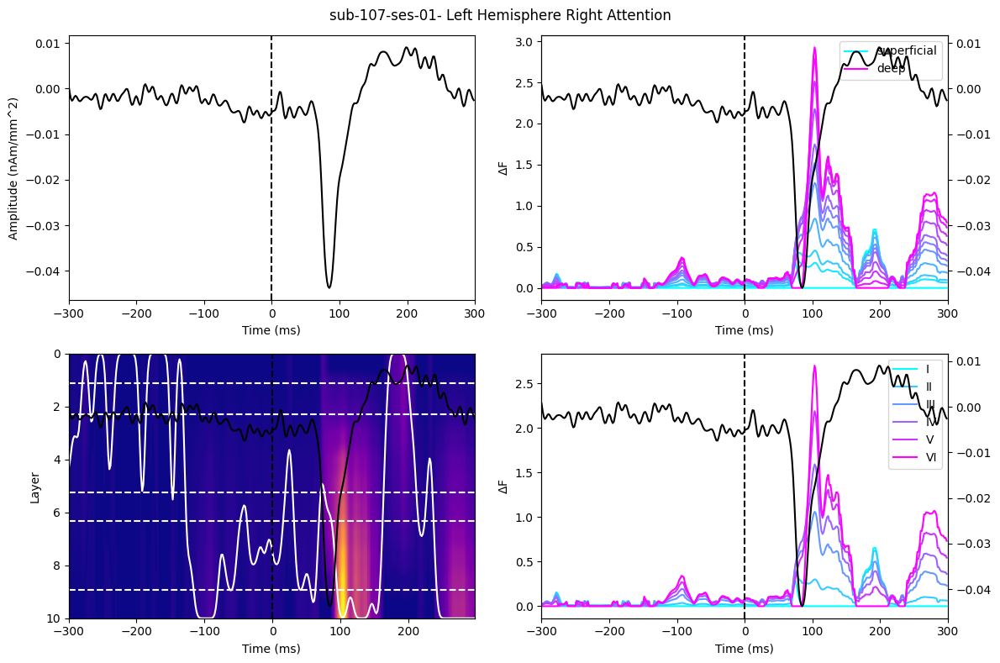

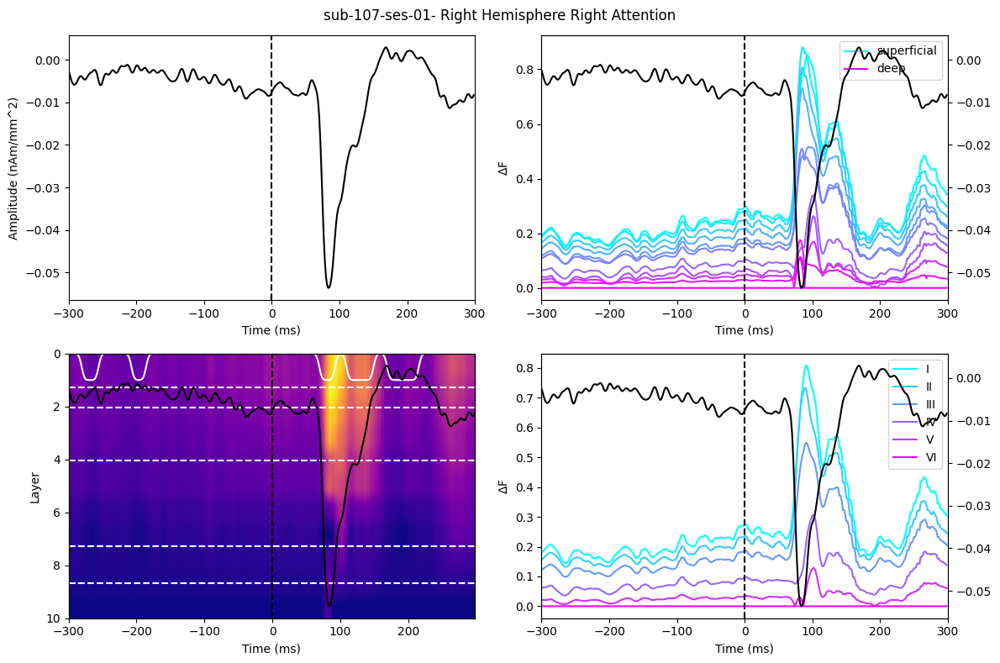

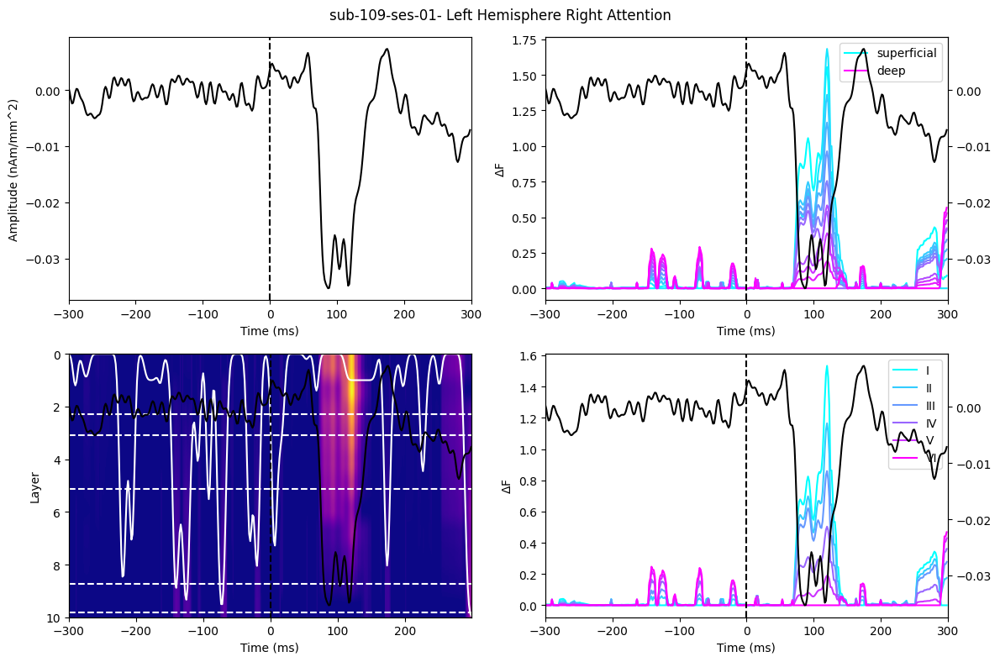

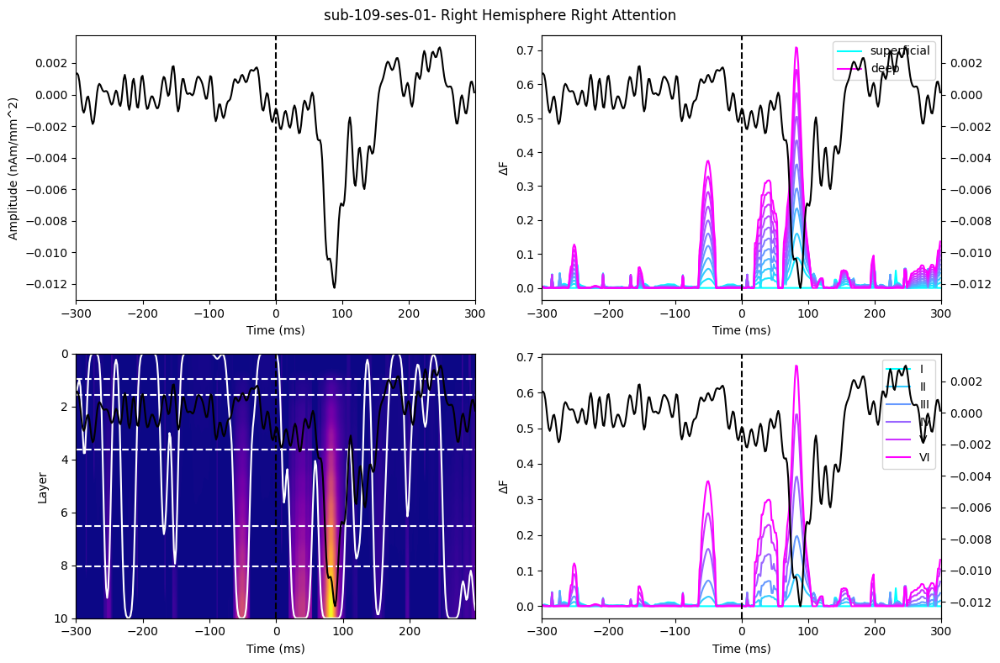

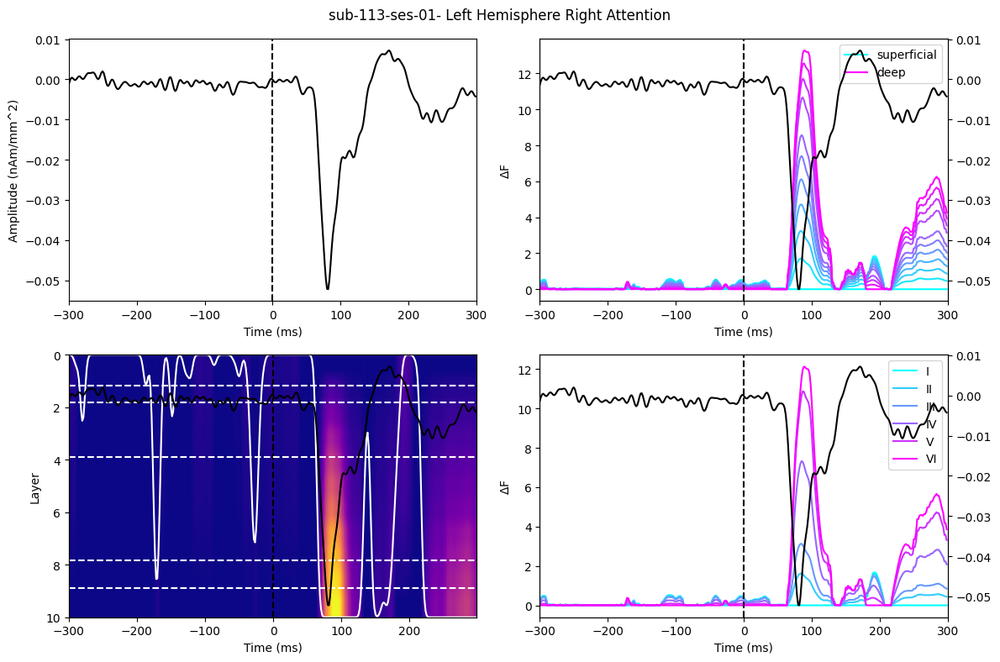

...

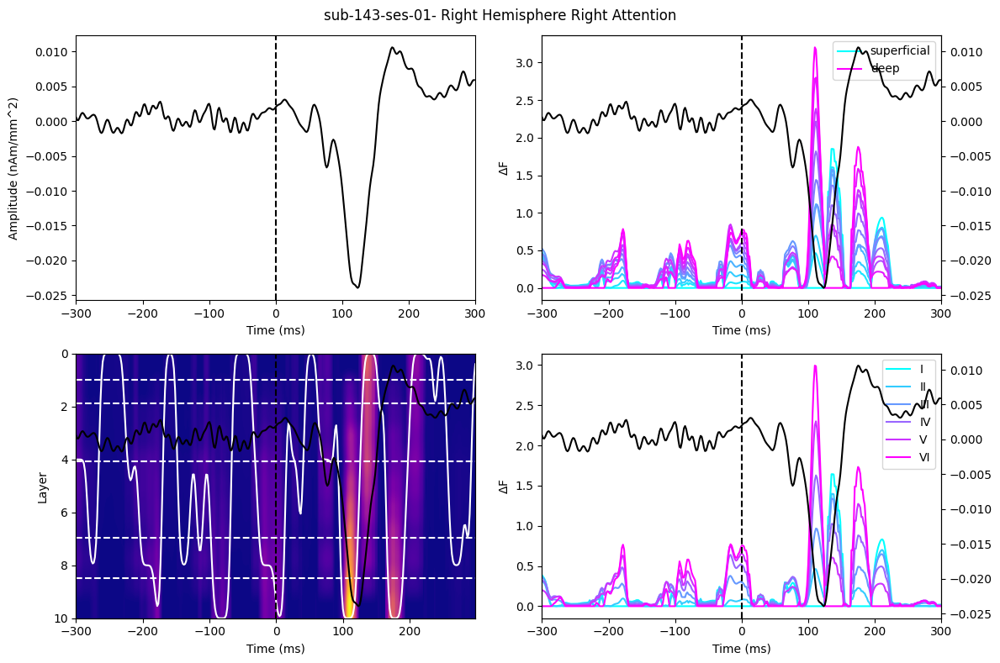

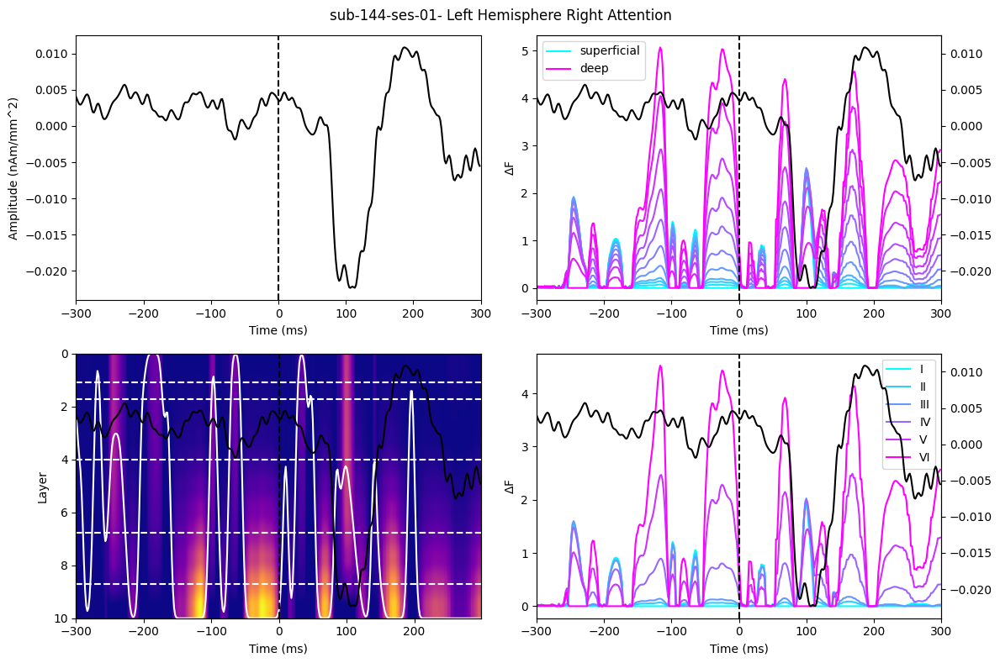

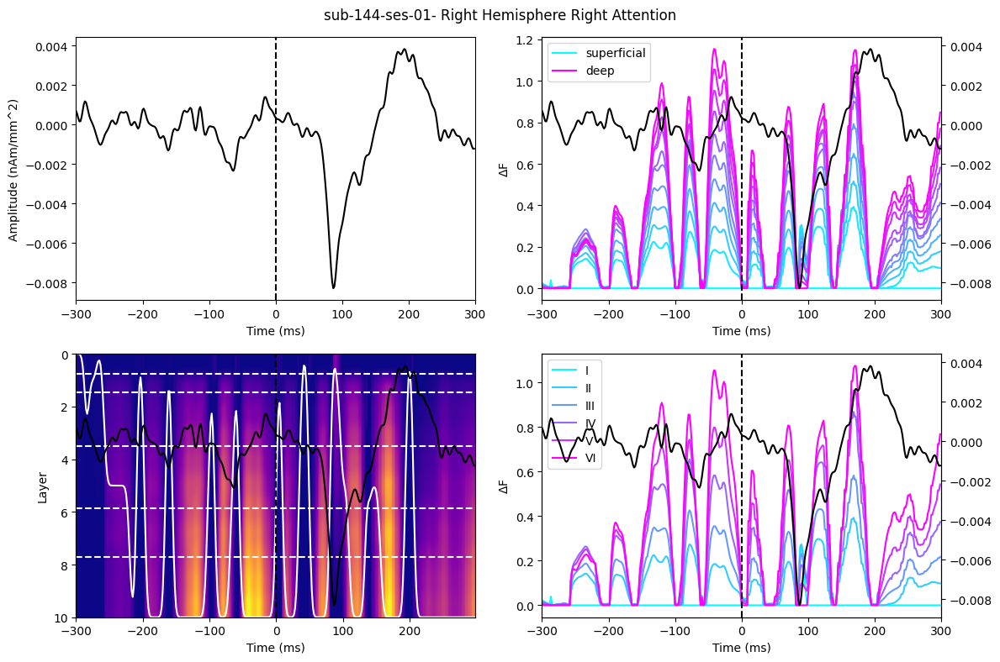

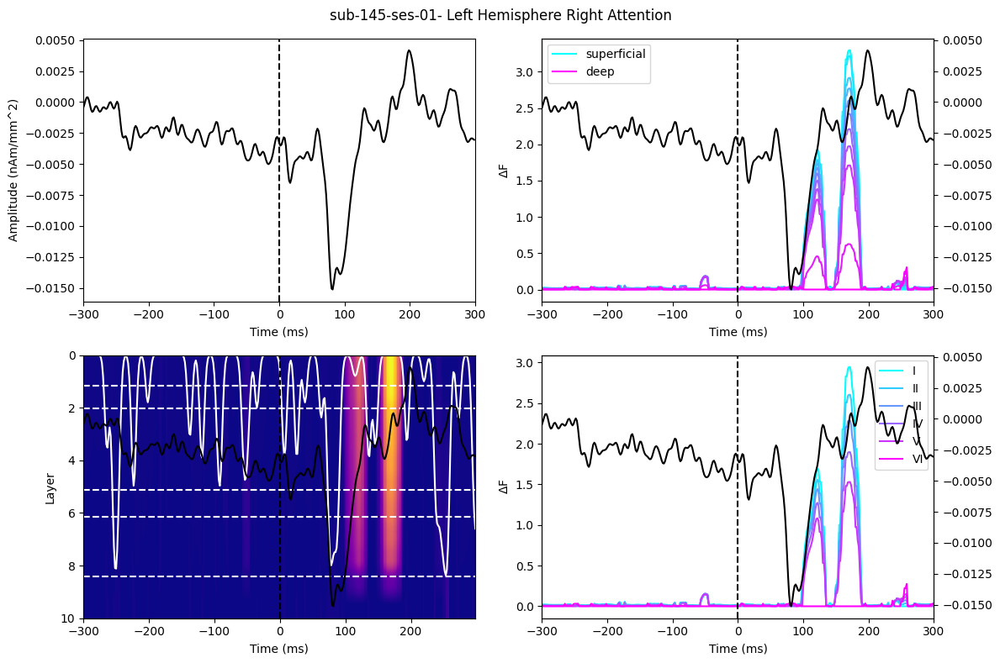

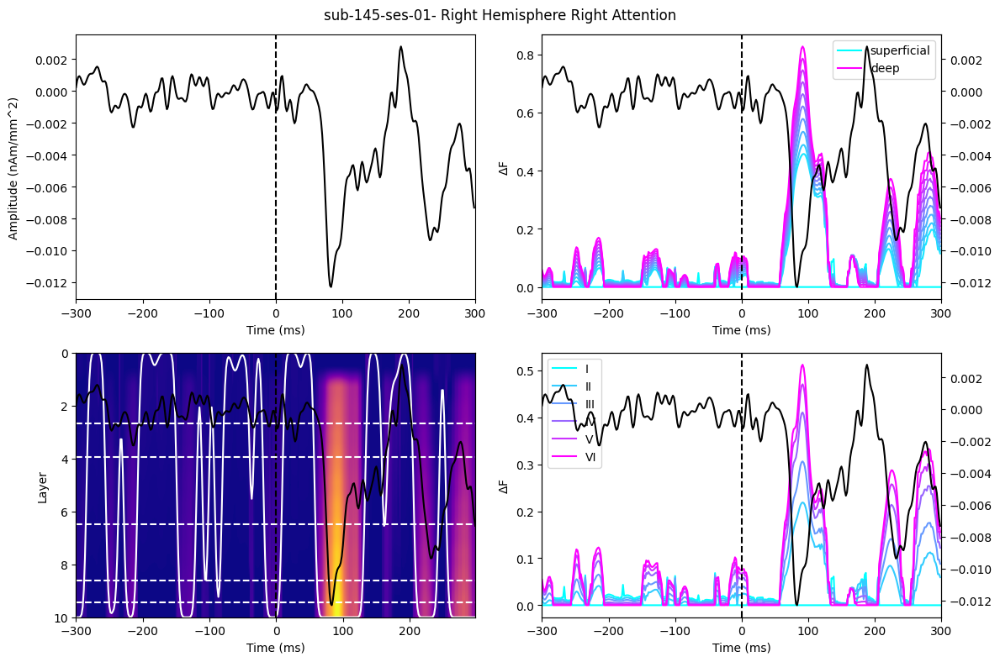

In [3]:
# Plot single subject right attention  

def plot_hemisphere_data(
    all_ra_prior_ts,
    all_ra_F_diff,
    all_ra_layer_F_diff,
    all_ra_bb_boundaries,
    subject,
    session,
    hemisphere,
    n_layers,
    woi_win,
    ts_time,
    time_lims,
    colormap='cool'
):
    col_r = plt.cm.get_cmap(colormap)(np.linspace(0, 1, num=n_layers))
    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    fig.suptitle(f'{subject}-{session}- {hemisphere} Hemisphere Right Attention')

    ax = axes[0, 0]
    ax.plot(ts_time, all_ra_prior_ts, 'k')
    ax.axvline(x=0, color='k', linestyle='--')
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel('Amplitude (nAm/mm^2)')
    ax.set_xlim(time_lims)

    ax = axes[0, 1]
    for l in range(n_layers):
        if l == 0:
            ax.plot(woi_win, all_ra_F_diff[l, :], label='superficial', color=col_r[l, :])
        elif l == n_layers - 1:
            ax.plot(woi_win, all_ra_F_diff[l, :], label='deep', color=col_r[l, :])
        else:
            ax.plot(woi_win, all_ra_F_diff[l, :], color=col_r[l, :])
    ax.legend()
    ax.axvline(x=0, color='k', linestyle='--')
    ax2 = ax.twinx()
    ax2.plot(ts_time, all_ra_prior_ts, 'k')
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel(r'$\Delta$F')
    ax.set_xlim(time_lims)

    ax = axes[1, 0]
    h = ax.imshow(
        all_ra_F_diff,
        aspect='auto',
        extent=[woi_win[0], woi_win[-1], n_layers - 1, 0],
        cmap='plasma',
        origin='upper'
    )
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel('Layer')
    peak_layer = gaussian_filter1d(np.argmax(all_ra_F_diff, axis=0).astype(float), 2)
    ax.plot(woi_win, peak_layer, 'w')
    ax.axvline(x=0, color='k', linestyle='--')
    for i in range(len(all_ra_bb_boundaries) - 1):
        ax.axhline(y=all_ra_bb_boundaries[i], color='w', linestyle='--')
    ax2 = ax.twinx()
    ax2.plot(ts_time, all_ra_prior_ts, 'k')
    ax2.set_yticks([])

    ax = axes[1, 1]
    col_l = plt.cm.get_cmap(colormap)(np.linspace(0, 1, num=6))
    l_labels = ['I', 'II', 'III', 'IV', 'V', 'VI']
    for i in range(6):
        ax.plot(woi_win, all_ra_layer_F_diff[i, :], label=l_labels[i], color=col_l[i])
    ax.legend()
    ax.axvline(x=0, color='k', linestyle='--')
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel(r'$\Delta$F')
    ax2 = ax.twinx()
    ax2.plot(ts_time, all_ra_prior_ts, 'k')
    ax.set_xlim(time_lims)

    plt.tight_layout()
    plt.show()

for i, subject in enumerate(hi_snr_subjects):
    plot_hemisphere_data(
        all_lh_ra_prior_ts[i],
        all_lh_ra_F_diff[i],
        all_lh_ra_layer_F_diff[i],
        all_lh_ra_bb_boundaries[i],
        subject,
        session,
        'Left',
        n_layers,
        woi_win,
        ts_time,
        time_lims
    )
    plot_hemisphere_data(
        all_rh_ra_prior_ts[i],
        all_rh_ra_F_diff[i],
        all_rh_ra_layer_F_diff[i],
        all_rh_ra_bb_boundaries[i],
        subject,
        session,
        'Right',
        n_layers,
        woi_win,
        ts_time,
        time_lims
    )


In [4]:
# LEFT Attention Loop

all_lh_la_prior_ts=[]
all_lh_la_F_diff=[]
all_lh_la_layer_F_diff=[]
all_lh_la_bb_boundaries=[]

all_rh_la_prior_ts=[]
all_rh_la_F_diff=[]
all_rh_la_layer_F_diff=[]
all_rh_la_bb_boundaries=[]

for subject in hi_snr_subjects:
    sub_n=subject.split('-')[-1]
    for sess_idx, session in enumerate(sessions[subject]):
        out_fname = os.path.join(out_dir,f'results_{subject}_{session}_left_stim.npz') 
        if os.path.exists(out_fname):
            subj_surf_dir=os.path.join(braindyn_files,f'{sub_n}-synth','layer_surf')
            
            orig_inflated=nib.load(os.path.join(subj_surf_dir, 'inflated.gii'))
            ds_inflated=nib.load(os.path.join(subj_surf_dir, 'inflated.ds.gii'))
            ds_pial = nib.load(os.path.join(subj_surf_dir, 'pial.ds.gii'))

            data = np.load(out_fname, allow_pickle=True)
            lh_prior = data['lh_prior']
            lh_prior_ts = data['lh_prior_ts']
            rh_prior = data['rh_prior']
            rh_prior_ts = data['rh_prior_ts']
            ts_time = data['ts_time']
            lh_Fs = data['lh_Fs']
            rh_Fs = data['rh_Fs']
            wois = data['wois']

            woi_time=np.mean(wois,axis=-1)
            t_idx=np.where((woi_time>=time_lims[0]) & (woi_time<=time_lims[1]))[0]
            woi_win=woi_time[t_idx]
            lh_Fs_win=lh_Fs[:,t_idx]
            rh_Fs_win=rh_Fs[:,t_idx]

            ts_idx=np.where((ts_time>=time_lims[0]) & (ts_time<=time_lims[1]))[0]
            lh_prior_ts=lh_prior_ts[ts_idx]
            rh_prior_ts=rh_prior_ts[ts_idx]
            ts_time=ts_time[ts_idx]
            
            m_idx=np.argmax(np.abs(lh_prior_ts))
            if lh_prior_ts[m_idx]>0:
                lh_prior_ts=-1*lh_prior_ts
            m_idx=np.argmax(np.abs(rh_prior_ts))
            if rh_prior_ts[m_idx]>0:
                rh_prior_ts=-1*rh_prior_ts

            # Compute the relative free energy for each layer model, compared to the worst model at each time step
            lh_F_diff = np.zeros((lh_Fs_win.shape[0],lh_Fs_win.shape[1]))
            for t in range(lh_Fs_win.shape[1]):
                minF = np.min(lh_Fs_win[:,t])
                lh_F_diff[:,t] = lh_Fs_win[:,t]-minF
            rh_F_diff = np.zeros((rh_Fs_win.shape[0],rh_Fs_win.shape[1]))
            for t in range(rh_Fs_win.shape[1]):
                minF = np.min(rh_Fs_win[:,t])
                rh_F_diff[:,t] = rh_Fs_win[:,t]-minF
                
            lh_surf_bb_bounds=n_layers*get_bigbrain_layer_boundaries(f'{sub_n}-synth', subj_surf_dir, subj_coord=ds_pial.darrays[0].data[lh_prior,:])
            
            lh_idx = split_into_6_layers(n_layers, lh_surf_bb_bounds)

            lh_layer_F = np.vstack([ 
                np.mean(lh_Fs_win[lh_idx[0], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[1], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[2], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[3], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[4], :], axis=0), 
                np.mean(lh_Fs_win[lh_idx[5], :], axis=0), 
            ])
            
            lh_layer_F_diff = np.zeros((lh_layer_F.shape[0],lh_layer_F.shape[1]))
            for t in range(lh_layer_F.shape[1]):
                minF = np.nanmin(lh_layer_F[:,t])
                lh_layer_F_diff[:,t] = lh_layer_F[:,t]-minF
                
            
            rh_surf_bb_bounds=n_layers*get_bigbrain_layer_boundaries(f'{sub_n}-synth', subj_surf_dir, subj_coord=ds_pial.darrays[0].data[rh_prior,:])
            
            rh_idx = split_into_6_layers(n_layers, rh_surf_bb_bounds)

            rh_layer_F = np.vstack([ 
                np.mean(rh_Fs_win[rh_idx[0], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[1], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[2], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[3], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[4], :], axis=0), 
                np.mean(rh_Fs_win[rh_idx[5], :], axis=0), 
            ])
            
            rh_layer_F_diff = np.zeros((rh_layer_F.shape[0],rh_layer_F.shape[1]))
            for t in range(rh_layer_F.shape[1]):
                minF = np.nanmin(rh_layer_F[:,t])
                rh_layer_F_diff[:,t] = rh_layer_F[:,t]-minF
            
            all_lh_la_prior_ts.append(lh_prior_ts)
            all_lh_la_F_diff.append(lh_F_diff)
            all_lh_la_layer_F_diff.append(lh_layer_F_diff)
            all_lh_la_bb_boundaries.append(lh_surf_bb_bounds)
            
            all_rh_la_prior_ts.append(rh_prior_ts)
            all_rh_la_F_diff.append(rh_F_diff)
            all_rh_la_layer_F_diff.append(rh_layer_F_diff)
            all_rh_la_bb_boundaries.append(rh_surf_bb_bounds)

all_lh_la_prior_ts=np.array(all_lh_la_prior_ts)
all_lh_la_F_diff=np.array(all_lh_la_F_diff)
all_lh_la_layer_F_diff=np.array(all_lh_la_layer_F_diff)
all_lh_la_bb_boundaries=np.array(all_lh_la_bb_boundaries)

all_rh_la_prior_ts=np.array(all_rh_la_prior_ts)
all_rh_la_F_diff=np.array(all_rh_la_F_diff)
all_rh_la_layer_F_diff=np.array(all_rh_la_layer_F_diff)
all_rh_la_bb_boundaries=np.array(all_rh_la_bb_boundaries)

Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged
Merged


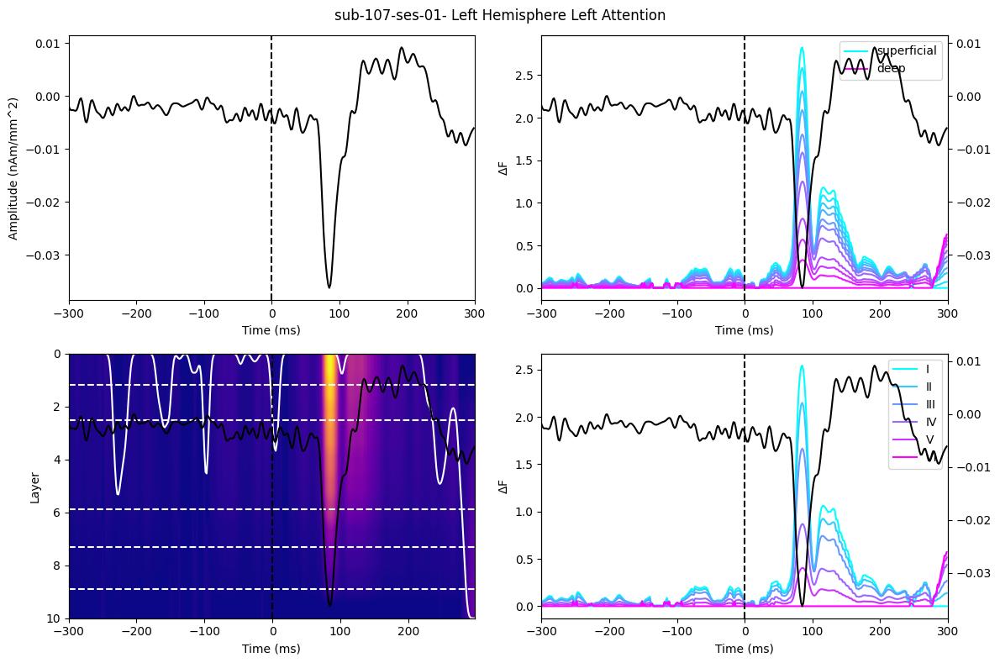

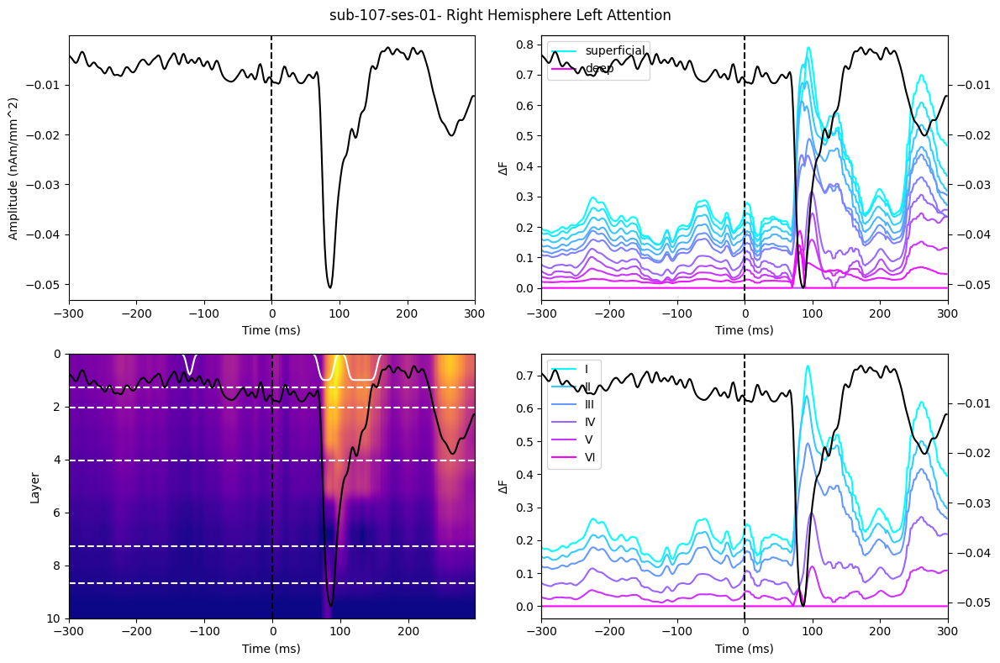

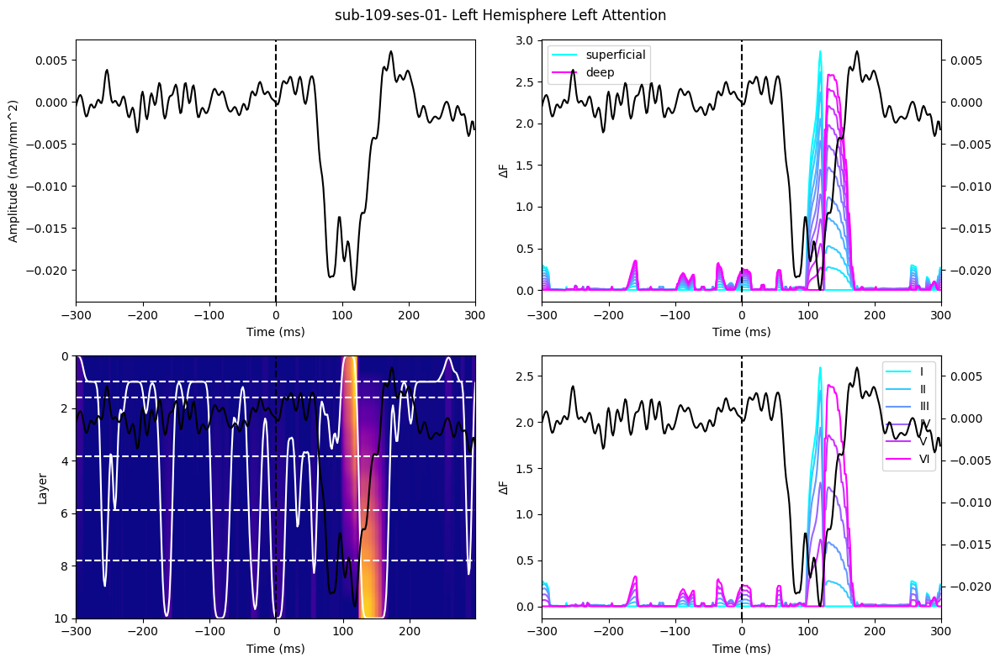

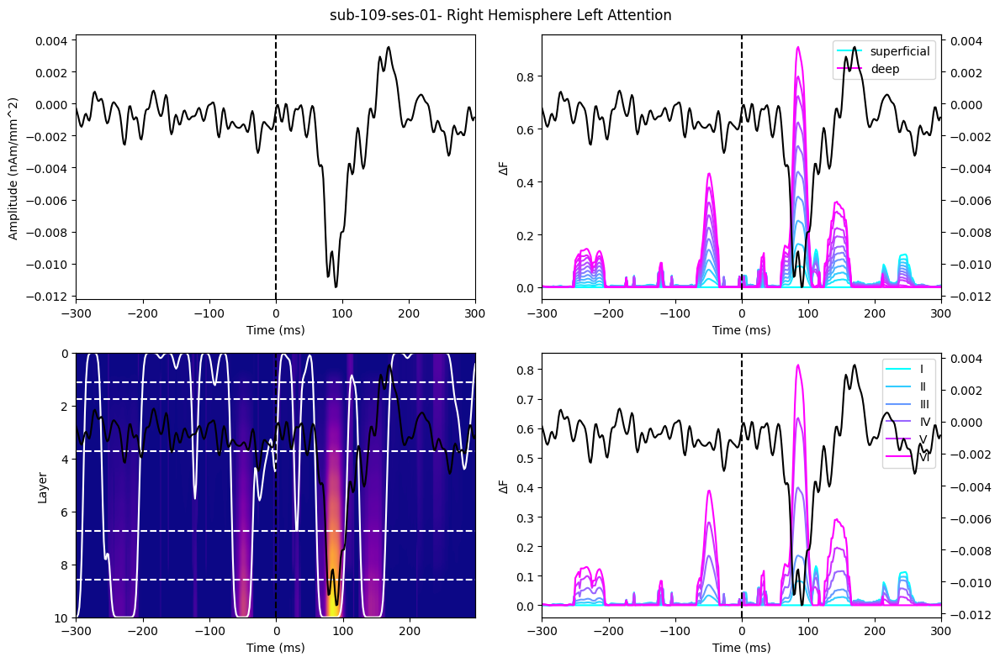

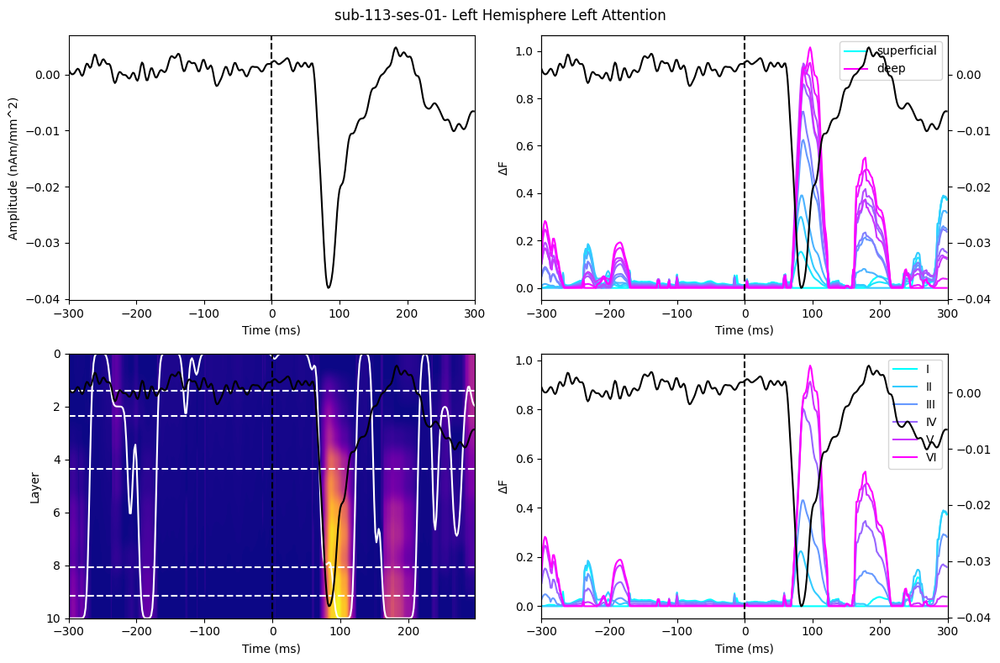

...

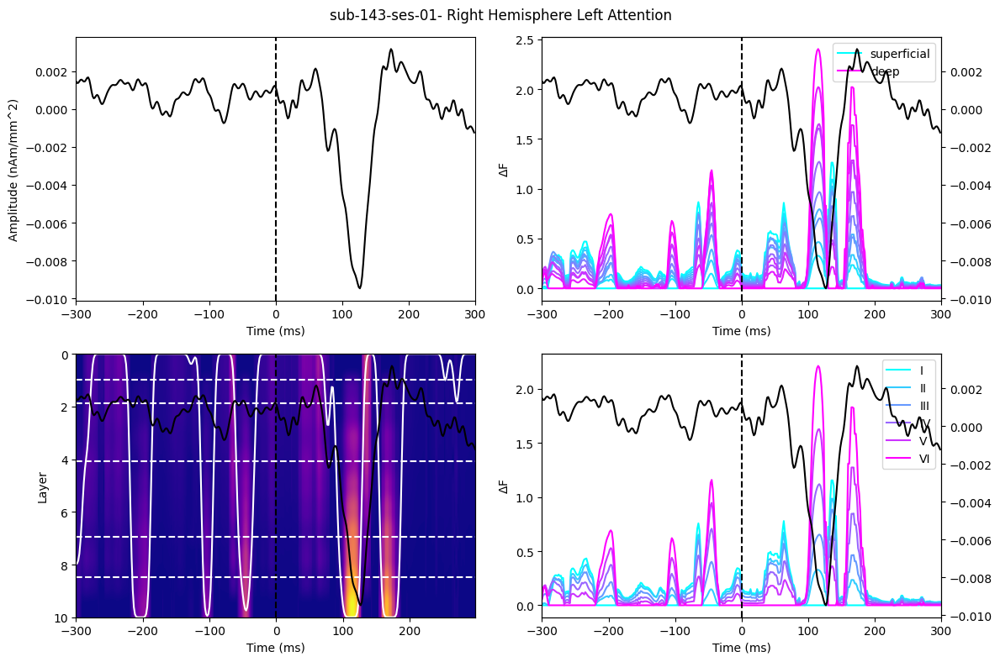

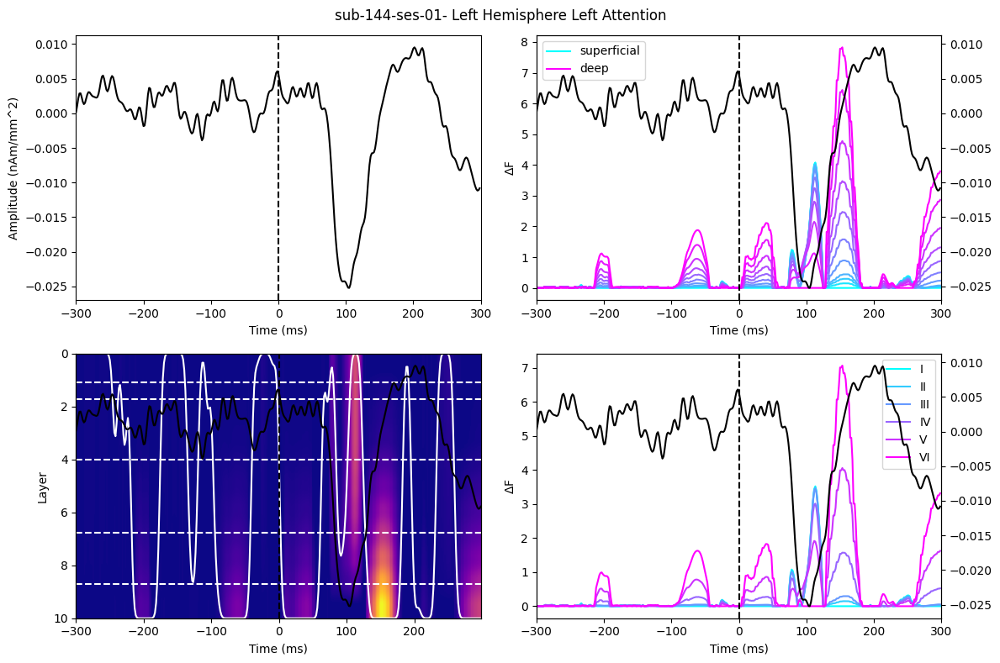

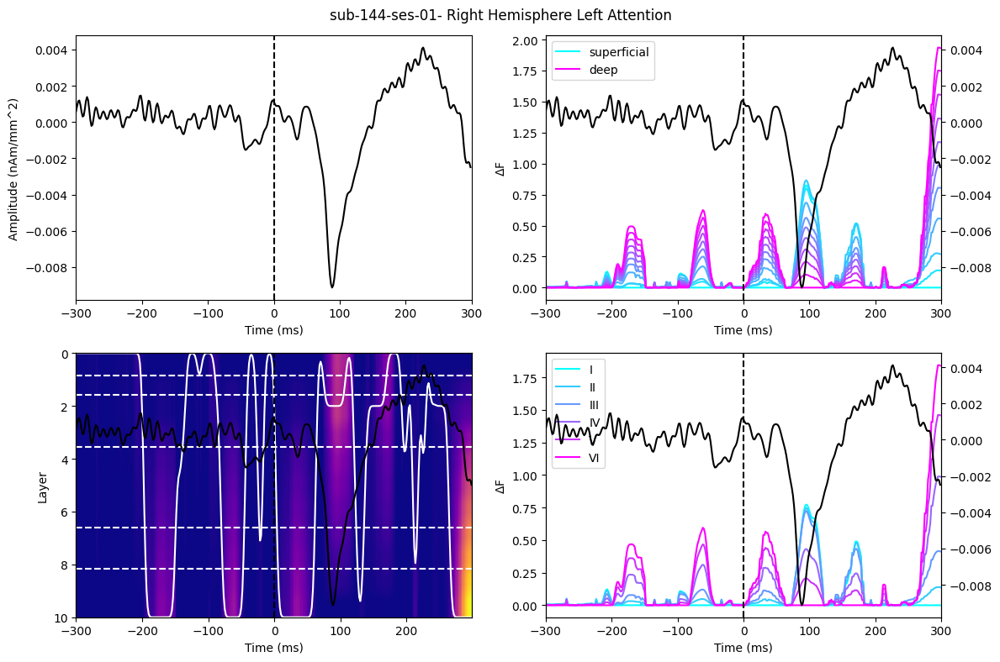

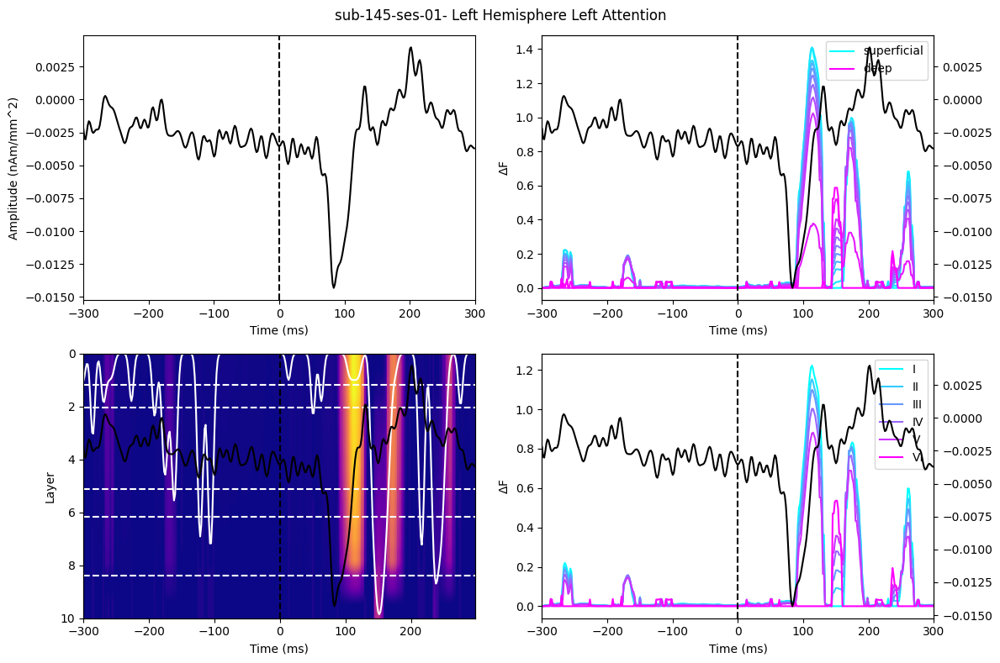

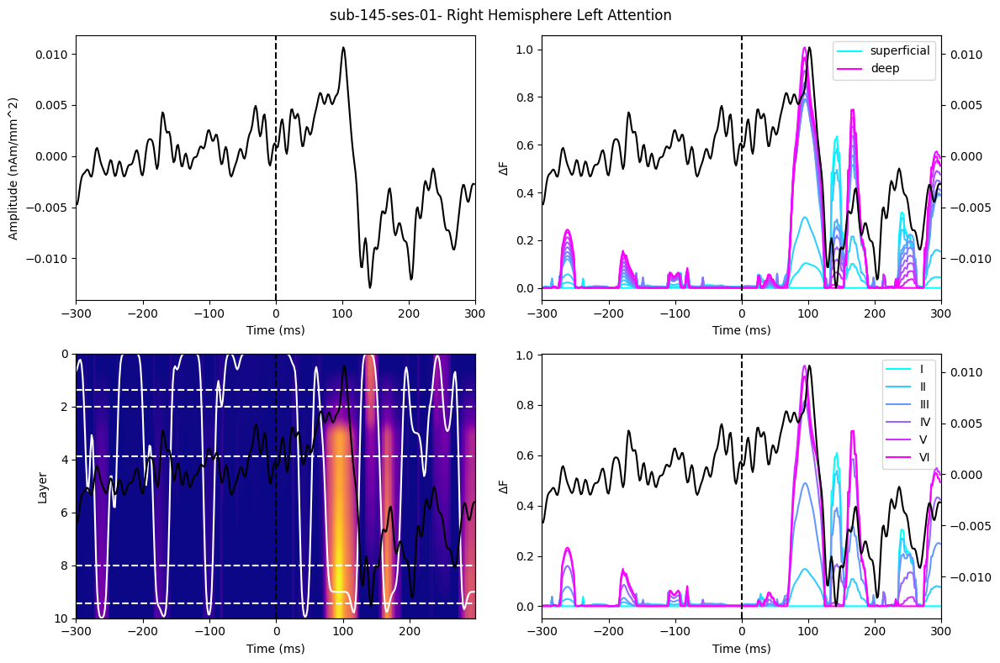

In [5]:
# Plot single subjects left attention

def plot_hemisphere_data(
    all_la_prior_ts,
    all_la_F_diff,
    all_la_layer_F_diff,
    all_la_bb_boundaries,
    subject,
    session,
    hemisphere,
    n_layers,
    woi_win,
    ts_time,
    time_lims,
    colormap='cool'
):
    col_r = plt.cm.get_cmap(colormap)(np.linspace(0, 1, num=n_layers))
    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    fig.suptitle(f'{subject}-{session}- {hemisphere} Hemisphere Left Attention')

    ax = axes[0, 0]
    ax.plot(ts_time, all_la_prior_ts, 'k')
    ax.axvline(x=0, color='k', linestyle='--')
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel('Amplitude (nAm/mm^2)')
    ax.set_xlim(time_lims)

    ax = axes[0, 1]
    for l in range(n_layers):
        if l == 0:
            ax.plot(woi_win, all_la_F_diff[l, :], label='superficial', color=col_r[l, :])
        elif l == n_layers - 1:
            ax.plot(woi_win, all_la_F_diff[l, :], label='deep', color=col_r[l, :])
        else:
            ax.plot(woi_win, all_la_F_diff[l, :], color=col_r[l, :])
    ax.legend()
    ax.axvline(x=0, color='k', linestyle='--')
    ax2 = ax.twinx()
    ax2.plot(ts_time, all_la_prior_ts, 'k')
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel(r'$\Delta$F')
    ax.set_xlim(time_lims)

    ax = axes[1, 0]
    h = ax.imshow(
        all_la_F_diff,
        aspect='auto',
        extent=[woi_win[0], woi_win[-1], n_layers - 1, 0],
        cmap='plasma',
        origin='upper'
    )
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel('Layer')
    peak_layer = gaussian_filter1d(np.argmax(all_la_F_diff, axis=0).astype(float), 2)
    ax.plot(woi_win, peak_layer, 'w')
    ax.axvline(x=0, color='k', linestyle='--')
    for i in range(len(all_la_bb_boundaries) - 1):
        ax.axhline(y=all_la_bb_boundaries[i], color='w', linestyle='--')
    ax2 = ax.twinx()
    ax2.plot(ts_time, all_la_prior_ts, 'k')
    ax2.set_yticks([])

    ax = axes[1, 1]
    col_l = plt.cm.get_cmap(colormap)(np.linspace(0, 1, num=6))
    l_labels = ['I', 'II', 'III', 'IV', 'V', 'VI']
    for i in range(6):
        ax.plot(woi_win, all_la_layer_F_diff[i, :], label=l_labels[i], color=col_l[i])
    ax.legend()
    ax.axvline(x=0, color='k', linestyle='--')
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel(r'$\Delta$F')
    ax2 = ax.twinx()
    ax2.plot(ts_time, all_la_prior_ts, 'k')
    ax.set_xlim(time_lims)

    plt.tight_layout()
    plt.show()

for i, subject in enumerate(hi_snr_subjects):
    plot_hemisphere_data(
        all_lh_la_prior_ts[i],
        all_lh_la_F_diff[i],
        all_lh_la_layer_F_diff[i],
        all_lh_la_bb_boundaries[i],
        subject,
        session,
        'Left',
        n_layers,
        woi_win,
        ts_time,
        time_lims
    )
    plot_hemisphere_data(
        all_rh_la_prior_ts[i],
        all_rh_la_F_diff[i],
        all_rh_la_layer_F_diff[i],
        all_rh_la_bb_boundaries[i],
        subject,
        session,
        'Right',
        n_layers,
        woi_win,
        ts_time,
        time_lims
    )


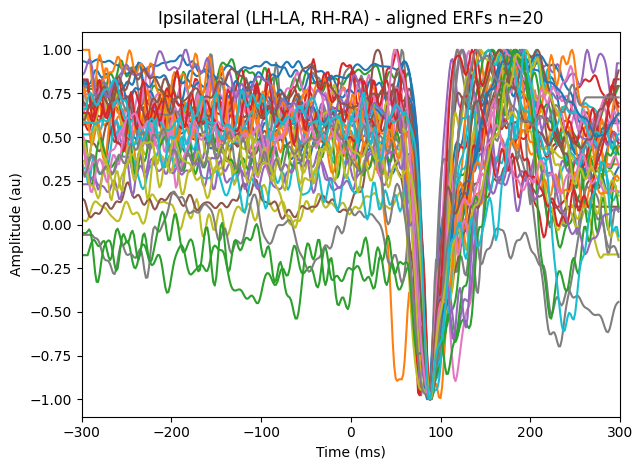

In [6]:
# IPSILATERAL (LH-LA, RH-RA) ERF peak alignment

ipsilateral_prior_ts = np.concatenate((all_lh_la_prior_ts, all_rh_ra_prior_ts), axis = 0)
ipsilateral_F_diff = np.concatenate((all_lh_la_F_diff,all_rh_ra_F_diff), axis = 0)
ipsilateral_layer_F_diff = np.concatenate((all_lh_la_layer_F_diff, all_rh_ra_layer_F_diff), axis = 0)
ipsilateral_bb_boundaries = np.concatenate((all_lh_la_bb_boundaries, all_rh_ra_bb_boundaries), axis = 0)

plt.figure()
plt.plot(ts_time, minmax_unit(ipsilateral_prior_ts[0]))
lh_lags, lh_align_idx = align_to_abs_peak_with_edges_time(ipsilateral_prior_ts, peak_window=(0.05, 0.150))

aligned_ipsilateral_prior_ts = []
aligned_ipsilateral_F_diff = []
aligned_ipsilateral_layer_F_diff = []

for i in range(ipsilateral_prior_ts.shape[0]):
    idx = lh_align_idx[i]
    if i > 0:
        plt.plot(ts_time, minmax_unit(ipsilateral_prior_ts[i, idx]))
    aligned_ipsilateral_prior_ts.append(ipsilateral_prior_ts[i, idx])
    aligned_ipsilateral_F_diff.append(ipsilateral_F_diff[i, :, idx])
    aligned_ipsilateral_layer_F_diff.append(ipsilateral_layer_F_diff[i, :, idx])

aligned_ipsilateral_prior_ts = np.asarray(aligned_ipsilateral_prior_ts)
aligned_ipsilateral_F_diff = np.transpose(np.asarray(aligned_ipsilateral_F_diff), (0, 2, 1))
aligned_ipsilateral_layer_F_diff = np.transpose(np.asarray(aligned_ipsilateral_layer_F_diff), (0, 2, 1))

plt.xlabel("Time (ms)")
plt.ylabel("Amplitude (au)")
plt.title(f"Ipsilateral (LH-LA, RH-RA) - aligned ERFs n={num_subj}")
plt.tight_layout(); plt.xlim(time_lims)
plt.show()


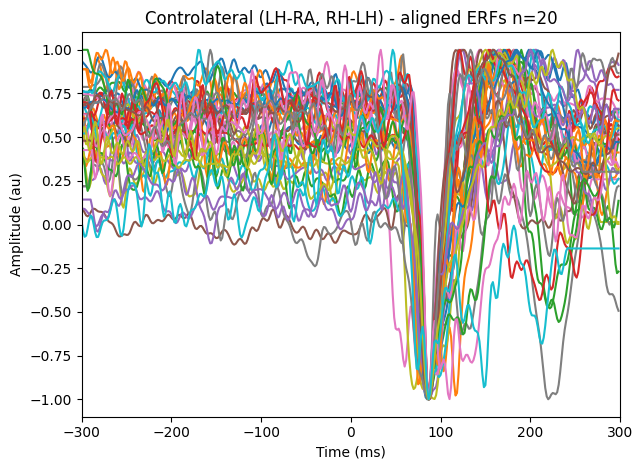

In [7]:
# CONTRALATERAL (LH-RA, RH-LA) ERF alignment

controlateral_prior_ts = np.concatenate((all_lh_ra_prior_ts, all_rh_la_prior_ts), axis = 0)
controlateral_F_diff = np.concatenate((all_lh_ra_F_diff, all_rh_la_F_diff), axis = 0)
controlateral_layer_F_diff = np.concatenate((all_lh_ra_layer_F_diff, all_rh_la_layer_F_diff), axis = 0)
controlateral_bb_boundaries = np.concatenate((all_lh_ra_bb_boundaries, all_rh_la_bb_boundaries), axis = 0)

plt.figure()
plt.plot(ts_time, minmax_unit(controlateral_prior_ts[0]))
lh_lags, lh_align_idx = align_to_abs_peak_with_edges_time(controlateral_prior_ts, peak_window=(0.05, 0.150))

aligned_controlateral_prior_ts = []
aligned_controlateral_F_diff = []
aligned_controlateral_layer_F_diff = []

for i in range(controlateral_prior_ts.shape[0]):
    idx = lh_align_idx[i]
    if i > 0:
        plt.plot(ts_time, minmax_unit(controlateral_prior_ts[i, idx]))
    aligned_controlateral_prior_ts.append(controlateral_prior_ts[i, idx])
    aligned_controlateral_F_diff.append(controlateral_F_diff[i, :, idx])
    aligned_controlateral_layer_F_diff.append(controlateral_layer_F_diff[i, :, idx])

aligned_controlateral_prior_ts = np.asarray(aligned_controlateral_prior_ts)
aligned_controlateral_F_diff = np.transpose(np.asarray(aligned_controlateral_F_diff), (0, 2, 1))
aligned_controlateral_layer_F_diff = np.transpose(np.asarray(aligned_controlateral_layer_F_diff), (0, 2, 1))

plt.xlabel("Time (ms)")
plt.ylabel("Amplitude (au)")
plt.title(f"Controlateral (LH-RA, RH-LH) - aligned ERFs n={num_subj}")
plt.tight_layout(); plt.xlim(time_lims)
plt.show()


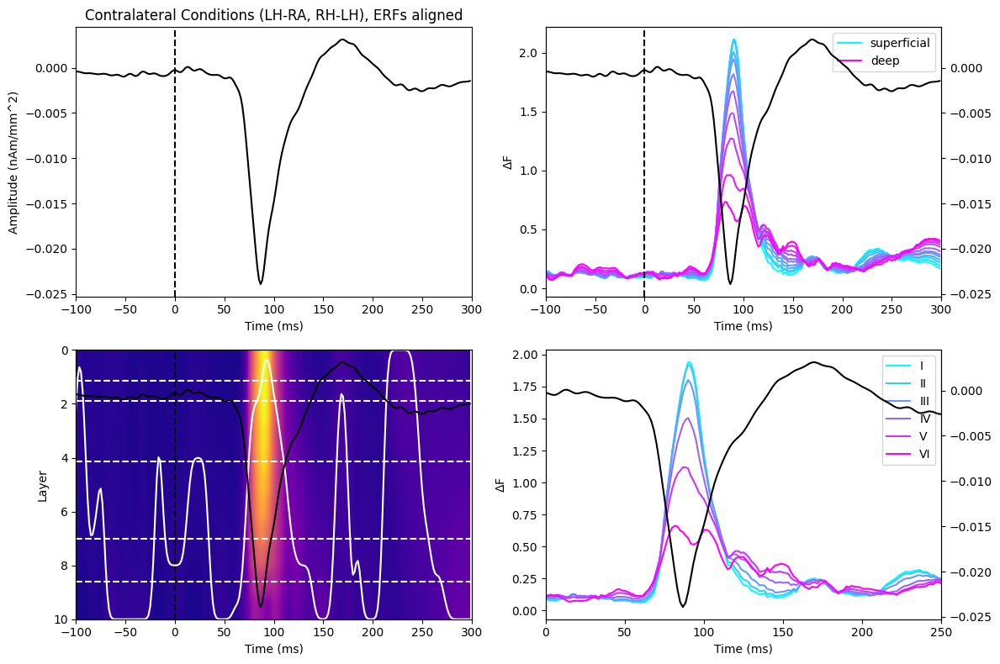

In [10]:
# ALIGNED CONTROLATERAL Deltas laminar 

m_aligned_controlateral_prior_ts=np.mean(aligned_controlateral_prior_ts,axis=0)
m_aligned_controlateral_F_diff=np.mean(aligned_controlateral_F_diff,axis=0)
m_aligned_controlateral_layer_F_diff=np.nanmean(aligned_controlateral_layer_F_diff,axis=0)
m_controlateral_bb_boundaries=np.mean(controlateral_bb_boundaries,axis=0)

col_r = plt.cm.cool(np.linspace(0,1, num=n_layers))
fig=plt.figure(figsize=(12,8))

ax=plt.subplot(2,2,1)
ax.plot(ts_time,m_aligned_controlateral_prior_ts,'k')
ax.axvline(x=0, color='k', linestyle='--')
# ax2=ax.twinx()
# ax2.plot(sensor_time, m_snrs)
ax.set_ylabel('Amplitude (nAm/mm^2)')
# ax2.set_ylabel('SNR (dB)')
ax.set_xlabel('Time (ms)')
#ax.set_xlim(time_lims)
ax.set_xlim([-100,300])
plt.title(f"Contralateral Conditions (LH-RA, RH-LH), ERFs aligned")

# Plot relative free energy time series
ax=plt.subplot(2,2,2)
for l in range(n_layers):
    if l==0:
        ax.plot(woi_win, m_aligned_controlateral_F_diff[l,:], label='superficial', color=col_r[l,:])
    elif l==n_layers-1:
        ax.plot(woi_win, m_aligned_controlateral_F_diff[l,:], label='deep', color=col_r[l,:])
    else:
        ax.plot(woi_win, m_aligned_controlateral_F_diff[l,:], color=col_r[l,:])
ax.axvline(x=0, color='k', linestyle='--')
plt.legend(loc='upper right')
ax2=ax.twinx()
ax2.plot(ts_time,m_aligned_controlateral_prior_ts,'k')
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
#ax.set_xlim(time_lims)
ax.set_xlim([-100,300])

ax=plt.subplot(2,2,3)
h=ax.imshow(m_aligned_controlateral_F_diff,aspect='auto', extent=[woi_win[0], woi_win[-1], n_layers-1,0],cmap='plasma',origin='upper')
ax.set_xlabel('Time (ms)')
ax.set_ylabel('Layer')
peak_layer=gaussian_filter1d(np.argmax(m_aligned_controlateral_F_diff,axis=0).astype(float), 2)
ax.plot(woi_win, peak_layer, 'w')
ax.axvline(x=0, color='k', linestyle='--')
for i in range(len(m_controlateral_bb_boundaries)-1):
    ax.axhline(y=m_controlateral_bb_boundaries[i],color='w',linestyle='--')        
# col_r=plt.colorbar(h)
# col_r.set_label(r'$\Delta$F')
# divider = make_axes_locatable(ax)
# cax = divider.append_axes("right", size="5%", pad=0.1)
# cbar = fig.colorbar(h, cax=cax, label=r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_aligned_controlateral_prior_ts,'k')
ax2.set_yticks([])
ax.set_xlim([-100,300])

ax=plt.subplot(2,2,4)
col_l = plt.cm.cool(np.linspace(0,1, num=6))
l_labels=['I','II','III','IV','V','VI']
for i in range(6):
    ax.plot(woi_win, m_aligned_controlateral_layer_F_diff[i,:],label=l_labels[i],color=col_l[i])
ax.axvline(x=0, color='k', linestyle='--')
plt.legend()
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_aligned_controlateral_prior_ts,'k')
# ax.set_xlim(time_lims)
ax.set_xlim([0,250])

plt.tight_layout()
plt.show()


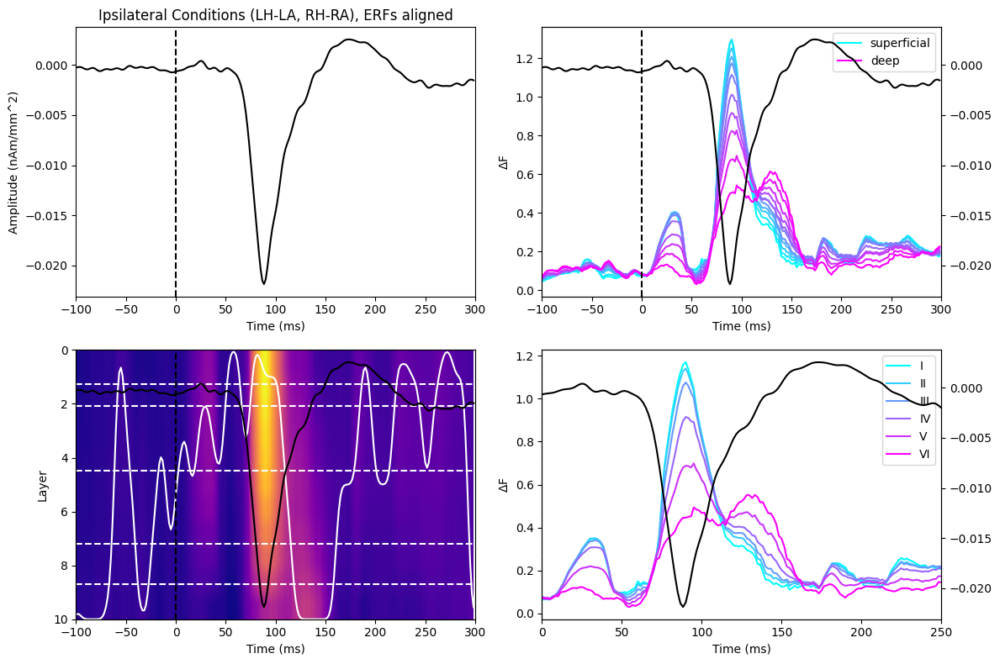

In [9]:
# ALIGNED IPSILATERAL laminar deltas 

m_aligned_ipsilateral_prior_ts=np.mean(aligned_ipsilateral_prior_ts,axis=0)
m_aligned_ipsilateral_F_diff=np.mean(aligned_ipsilateral_F_diff,axis=0)
m_aligned_ipsilateral_layer_F_diff=np.nanmean(aligned_ipsilateral_layer_F_diff,axis=0)
m_ipsilateral_bb_boundaries=np.mean(ipsilateral_bb_boundaries,axis=0)

col_r = plt.cm.cool(np.linspace(0,1, num=n_layers))
fig=plt.figure(figsize=(12,8))

ax=plt.subplot(2,2,1)
ax.plot(ts_time,m_aligned_ipsilateral_prior_ts,'k')
ax.axvline(x=0, color='k', linestyle='--')
# ax2=ax.twinx()
# ax2.plot(sensor_time, m_snrs)
ax.set_ylabel('Amplitude (nAm/mm^2)')
# ax2.set_ylabel('SNR (dB)')
ax.set_xlabel('Time (ms)')
#ax.set_xlim(time_lims)
ax.set_xlim([-100,300])
plt.title(f"Ipsilateral Conditions (LH-LA, RH-RA), ERFs aligned")

# Plot relative free energy time series
ax=plt.subplot(2,2,2)
for l in range(n_layers):
    if l==0:
        ax.plot(woi_win, m_aligned_ipsilateral_F_diff[l,:], label='superficial', color=col_r[l,:])
    elif l==n_layers-1:
        ax.plot(woi_win, m_aligned_ipsilateral_F_diff[l,:], label='deep', color=col_r[l,:])
    else:
        ax.plot(woi_win, m_aligned_ipsilateral_F_diff[l,:], color=col_r[l,:])
ax.axvline(x=0, color='k', linestyle='--')
plt.legend(loc='upper right')
ax2=ax.twinx()
ax2.plot(ts_time,m_aligned_ipsilateral_prior_ts,'k')
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
#ax.set_xlim(time_lims)
ax.set_xlim([-100,300])

ax=plt.subplot(2,2,3)
h=ax.imshow(m_aligned_ipsilateral_F_diff,aspect='auto', extent=[woi_win[0], woi_win[-1], n_layers-1,0],cmap='plasma',origin='upper')
ax.set_xlabel('Time (ms)')
ax.set_ylabel('Layer')
peak_layer=gaussian_filter1d(np.argmax(m_aligned_ipsilateral_F_diff,axis=0).astype(float), 2)
ax.plot(woi_win, peak_layer, 'w')
ax.axvline(x=0, color='k', linestyle='--')
for i in range(len(m_ipsilateral_bb_boundaries)-1):
    ax.axhline(y=m_ipsilateral_bb_boundaries[i],color='w',linestyle='--')        
# col_r=plt.colorbar(h)
# col_r.set_label(r'$\Delta$F')
# divider = make_axes_locatable(ax)
# cax = divider.append_axes("right", size="5%", pad=0.1)
# cbar = fig.colorbar(h, cax=cax, label=r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_aligned_ipsilateral_prior_ts,'k')
ax2.set_yticks([])
ax.set_xlim([-100,300])

ax=plt.subplot(2,2,4)
col_l = plt.cm.cool(np.linspace(0,1, num=6))
l_labels=['I','II','III','IV','V','VI']
for i in range(6):
    ax.plot(woi_win, m_aligned_ipsilateral_layer_F_diff[i,:],label=l_labels[i],color=col_l[i])
ax.axvline(x=0, color='k', linestyle='--')
plt.legend()
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_aligned_ipsilateral_prior_ts,'k')
# ax.set_xlim(time_lims)
ax.set_xlim([0,250])

plt.tight_layout()
plt.show()

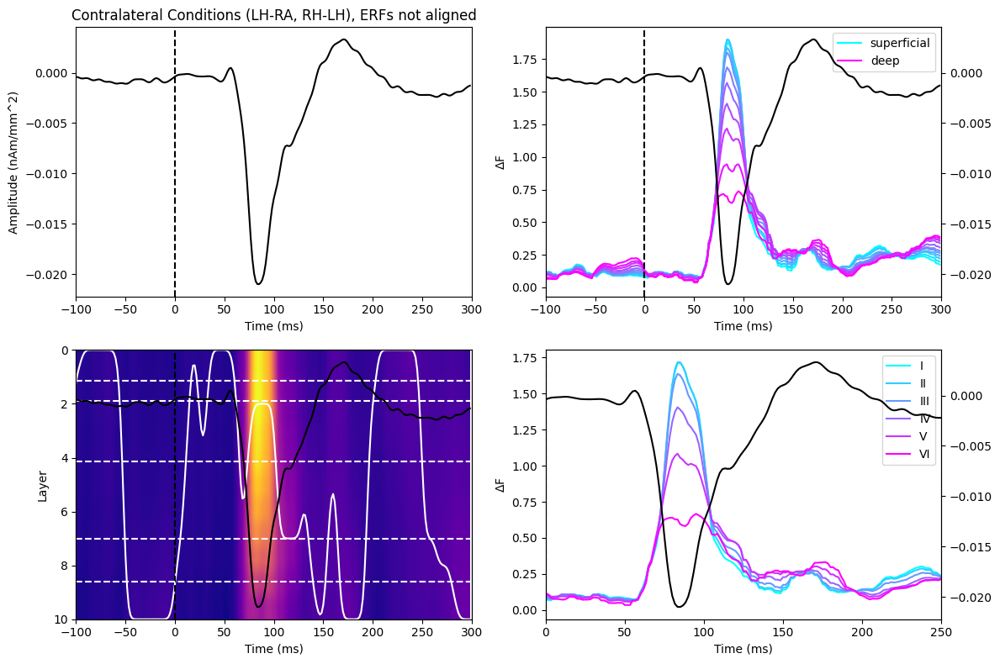

In [12]:
# NOT ALIGNED Laminar contralateral

m_controlateral_prior_ts=np.mean(controlateral_prior_ts,axis=0)
m_controlateral_F_diff=np.mean(controlateral_F_diff,axis=0)
m_controlateral_layer_F_diff=np.nanmean(controlateral_layer_F_diff,axis=0)
m_controlateral_bb_boundaries=np.mean(controlateral_bb_boundaries,axis=0)

col_r = plt.cm.cool(np.linspace(0,1, num=n_layers))
fig=plt.figure(figsize=(12,8))

ax=plt.subplot(2,2,1)
ax.plot(ts_time,m_controlateral_prior_ts,'k')
ax.axvline(x=0, color='k', linestyle='--')
# ax2=ax.twinx()
# ax2.plot(sensor_time, m_snrs)
ax.set_ylabel('Amplitude (nAm/mm^2)')
# ax2.set_ylabel('SNR (dB)')
ax.set_xlabel('Time (ms)')
#ax.set_xlim(time_lims)
ax.set_xlim([-100,300])
plt.title(f"Contralateral Conditions (LH-RA, RH-LH), ERFs not aligned")

# Plot relative free energy time series
ax=plt.subplot(2,2,2)
for l in range(n_layers):
    if l==0:
        ax.plot(woi_win, m_controlateral_F_diff[l,:], label='superficial', color=col_r[l,:])
    elif l==n_layers-1:
        ax.plot(woi_win, m_controlateral_F_diff[l,:], label='deep', color=col_r[l,:])
    else:
        ax.plot(woi_win, m_controlateral_F_diff[l,:], color=col_r[l,:])
ax.axvline(x=0, color='k', linestyle='--')
plt.legend(loc='upper right')
ax2=ax.twinx()
ax2.plot(ts_time,m_controlateral_prior_ts,'k')
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
ax.set_xlim([-100,300])
#ax.set_xlim(time_lims)

ax=plt.subplot(2,2,3)
h=ax.imshow(m_controlateral_F_diff,aspect='auto', extent=[woi_win[0], woi_win[-1], n_layers-1,0],cmap='plasma',origin='upper')
ax.set_xlabel('Time (ms)')
ax.set_ylabel('Layer')
peak_layer=gaussian_filter1d(np.argmax(m_controlateral_F_diff,axis=0).astype(float), 2)
ax.plot(woi_win, peak_layer, 'w')
ax.axvline(x=0, color='k', linestyle='--')
for i in range(len(m_controlateral_bb_boundaries)-1):
    ax.axhline(y=m_controlateral_bb_boundaries[i],color='w',linestyle='--')        
# col_r=plt.colorbar(h)
# col_r.set_label(r'$\Delta$F')
# divider = make_axes_locatable(ax)
# cax = divider.append_axes("right", size="5%", pad=0.1)
# cbar = fig.colorbar(h, cax=cax, label=r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_controlateral_prior_ts,'k')
ax2.set_yticks([])
ax.set_xlim([-100,300])


ax=plt.subplot(2,2,4)
col_l = plt.cm.cool(np.linspace(0,1, num=6))
l_labels=['I','II','III','IV','V','VI']
for i in range(6):
    ax.plot(woi_win, m_controlateral_layer_F_diff[i,:],label=l_labels[i],color=col_l[i])
ax.axvline(x=0, color='k', linestyle='--')
plt.legend()
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_controlateral_prior_ts,'k')
# ax.set_xlim(time_lims)
ax.set_xlim([0,250])

plt.tight_layout()
title_fig = "no-aligned_laminar_contra.png"
save_fig_path = os.path.join(figures_path,title_fig)
#plt.savefig(save_fig_path)
plt.show()


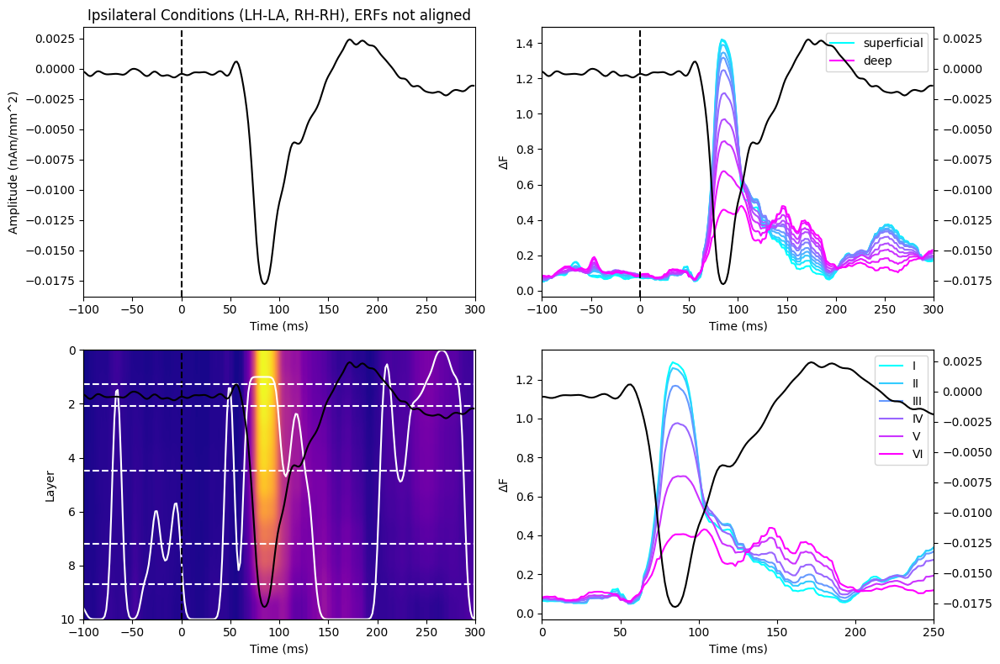

In [13]:
# NOT ALIGNED Laminar ipsilateral

m_ipsilateral_prior_ts=np.mean(ipsilateral_prior_ts,axis=0)
m_ipsilateral_F_diff=np.mean(ipsilateral_F_diff,axis=0)
m_ipsilateral_layer_F_diff=np.nanmean(ipsilateral_layer_F_diff,axis=0)
m_ipsilateral_bb_boundaries=np.mean(ipsilateral_bb_boundaries,axis=0)

col_r = plt.cm.cool(np.linspace(0,1, num=n_layers))
fig=plt.figure(figsize=(12,8))

ax=plt.subplot(2,2,1)
ax.plot(ts_time,m_ipsilateral_prior_ts,'k')
ax.axvline(x=0, color='k', linestyle='--')
# ax2=ax.twinx()
# ax2.plot(sensor_time, m_snrs)
ax.set_ylabel('Amplitude (nAm/mm^2)')
# ax2.set_ylabel('SNR (dB)')
ax.set_xlabel('Time (ms)')
#ax.set_xlim(time_lims)
ax.set_xlim([-100,300])
plt.title(f"Ipsilateral Conditions (LH-LA, RH-RH), ERFs not aligned")

# Plot relative free energy time series
ax=plt.subplot(2,2,2)
for l in range(n_layers):
    if l==0:
        ax.plot(woi_win, m_ipsilateral_F_diff[l,:], label='superficial', color=col_r[l,:])
    elif l==n_layers-1:
        ax.plot(woi_win, m_ipsilateral_F_diff[l,:], label='deep', color=col_r[l,:])
    else:
        ax.plot(woi_win, m_ipsilateral_F_diff[l,:], color=col_r[l,:])
ax.axvline(x=0, color='k', linestyle='--')
plt.legend(loc='upper right')
ax2=ax.twinx()
ax2.plot(ts_time,m_ipsilateral_prior_ts,'k')
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
ax.set_xlim([-100,300])
#ax.set_xlim(time_lims)

ax=plt.subplot(2,2,3)
h=ax.imshow(m_ipsilateral_F_diff,aspect='auto', extent=[woi_win[0], woi_win[-1], n_layers-1,0],cmap='plasma',origin='upper')
ax.set_xlabel('Time (ms)')
ax.set_ylabel('Layer')
peak_layer=gaussian_filter1d(np.argmax(m_ipsilateral_F_diff,axis=0).astype(float), 2)
ax.plot(woi_win, peak_layer, 'w')
ax.axvline(x=0, color='k', linestyle='--')
for i in range(len(m_ipsilateral_bb_boundaries)-1):
    ax.axhline(y=m_ipsilateral_bb_boundaries[i],color='w',linestyle='--')        
# col_r=plt.colorbar(h)
# col_r.set_label(r'$\Delta$F')
# divider = make_axes_locatable(ax)
# cax = divider.append_axes("right", size="5%", pad=0.1)
# cbar = fig.colorbar(h, cax=cax, label=r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_ipsilateral_prior_ts,'k')
ax2.set_yticks([])
ax.set_xlim([-100,300])


ax=plt.subplot(2,2,4)
col_l = plt.cm.cool(np.linspace(0,1, num=6))
l_labels=['I','II','III','IV','V','VI']
for i in range(6):
    ax.plot(woi_win, m_ipsilateral_layer_F_diff[i,:],label=l_labels[i],color=col_l[i])
ax.axvline(x=0, color='k', linestyle='--')
plt.legend()
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_ipsilateral_prior_ts,'k')
# ax.set_xlim(time_lims)
ax.set_xlim([0,250])

plt.tight_layout()
plt.show()


(0.0, 250.0)

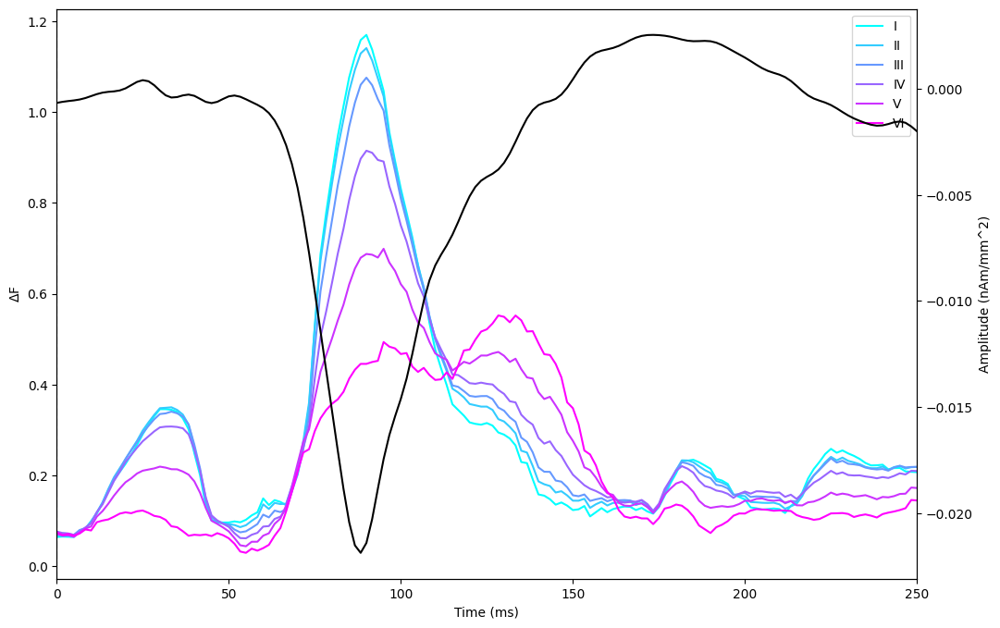

In [14]:
fig, ax = plt.subplots(figsize=(12, 8))

col_l = plt.cm.cool(np.linspace(0,1, num=6))
l_labels=['I','II','III','IV','V','VI']
for i in range(6):
    ax.plot(woi_win, m_aligned_ipsilateral_layer_F_diff[i,:],label=l_labels[i],color=col_l[i])
ax.axvline(x=0, color='k', linestyle='--')

plt.legend()
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_aligned_ipsilateral_prior_ts,'k')
ax2.set_ylabel('Amplitude (nAm/mm^2)', rotation=90)

ax.set_xlim([0,250])

(0.0, 250.0)

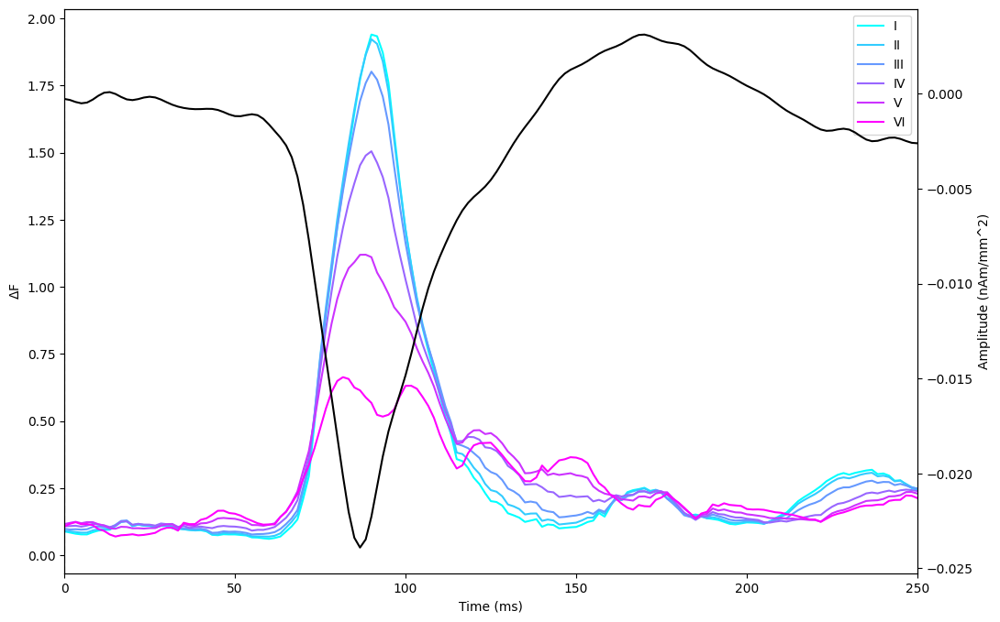

In [15]:
fig, ax = plt.subplots(figsize=(12, 8))

col_l = plt.cm.cool(np.linspace(0,1, num=6))
l_labels=['I','II','III','IV','V','VI']
for i in range(6):
    ax.plot(woi_win, m_aligned_controlateral_layer_F_diff[i,:],label=l_labels[i],color=col_l[i])
ax.axvline(x=0, color='k', linestyle='--')

plt.legend()
ax.set_xlabel('Time (ms)')
ax.set_ylabel(r'$\Delta$F')
ax2=ax.twinx()
ax2.plot(ts_time,m_aligned_controlateral_prior_ts,'k')
ax2.set_ylabel('Amplitude (nAm/mm^2)', rotation=90)

ax.set_xlim([0,250])